# 2. Visualizing convnet filters

Another easy way to inspect the filters learned by convnets is to display the visual pattern that each filter is meat to respond to. This can be done with gradient ascent in input space: applying gradient descent to the value of the input image of a convnet so as to maximize the response of a specific filter. Starting from a blank input image. The resulting input image will be one that the chosen filter is maximally responsive to.

### Defining the loss tensor for filter visualization

In [1]:
from keras.applications import VGG16
from keras import backend as K
import tensorflow as tf

tf.compat.v1.disable_eager_execution()

model = VGG16(weights='imagenet', include_top=False)

layer_name = 'block3_conv1'
filter_index = 0

layer_output = model.get_layer(layer_name).output
loss = K.mean(layer_output[:, :, :, filter_index])

# Obtaining the gradient of the loss with regard to the input

In [2]:
# The call to gradients returns a list of tensors (of size 1 in this case).
# Hence, you keep only the first element -- which is a tensor

# tf.gradients is not supported when eager execution is enabled. Use tf.GradientTape instead.
grads = K.gradients(loss, model.inputs)[0]

### Gradient-normalization trick

In [3]:
# Add 1e-5 before dividing to avoid accidentally dividing by 0

grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

### Fetching Numpy output values given Numpy input values

In [5]:
import numpy as np

iterate = K.function([model.inputs], [loss, grads])
loss_value, grads_value = iterate([np.zeros((1, 150, 150, 3))])

### Loss maximization via stochastic gradient descent

In [6]:
# Starts from a gray image with some noise
input_img_data = np.random.random((1, 150, 150, 3)) * 20 + 128.

# Magnitude of each gradient update
step = 1.
for i in range(40):
    # Computes the loss value & gradient value
    loss_value, grads_value = iterate([input_img_data])

    # Adjusts the input image in the direction that maximizes the loss
    input_img_data += grads_value * step

### Utility function to convert a tensor into a valid image

In [7]:
def deprocess_image(x):
    # Normalize the tensor: centers on 0, ensures that std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # Clips to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # Convert to an RGB array
    x *= 255
    x = np.clip(x, 0, 255).astype("uint8")

    return x

### Function to generate filter visualizations

In [16]:
def generate_pattern(layer_name_, filter_index_, size_=150):
    # Builds a loss function that maximizes the activation
    # of the n-th filter of the layer under consideration
    layer_output_ = model.get_layer(layer_name_).output
    loss_ = K.mean(layer_output_[:, :, :, filter_index_])

    # Computes the gradient of the input picture with regard to this loss
    grads_ = K.gradients(loss_, model.input)[0]

    # Normalization trick: normalizes the gradient
    grads_ /= (K.sqrt(K.mean(K.square(grads_))) + 1e-5)

    # Returns the loss and grads given the input picture
    iterate_ = K.function([model.input], [loss_, grads_])

    # Starts from a gray image with some noise
    input_img_data_ = np.random.random((1, size_, size_, 3)) * 20 + 128.
    step_ = 1.

    # Runs gradient ascent for 40 steps
    for i_ in range(40):
        loss_value_, grads_value_ = iterate_([input_img_data_])
        input_img_data_ += grads_value_ * step_
    img_ = input_img_data_[0]
    return deprocess_image(img_)

In [12]:
import matplotlib.pyplot as plt

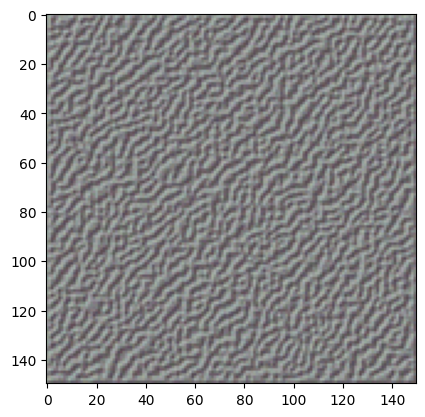

In [27]:
plt.imshow(generate_pattern('block1_conv1', 0, size_=150))

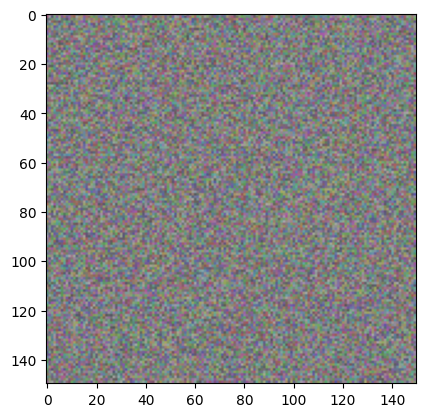

In [19]:
plt.imshow(generate_pattern('block2_conv1', 0))

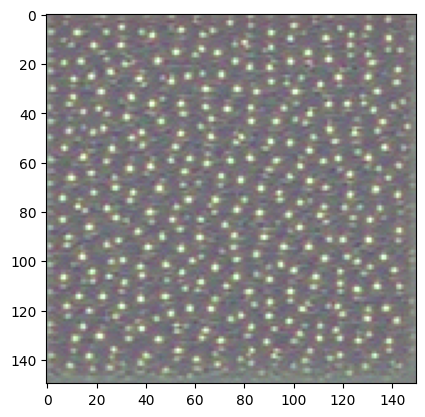

In [20]:
plt.imshow(generate_pattern('block3_conv1', 0))

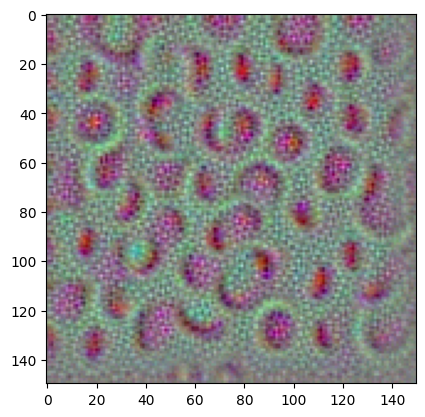

In [21]:
plt.imshow(generate_pattern('block4_conv1', 0))

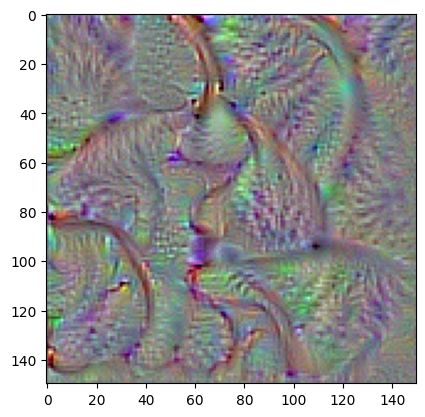

In [22]:
plt.imshow(generate_pattern('block5_conv1', 0))

### Generating a grid of all filter response patters in a layer

In [44]:
def draw_layer_filters(layer_name_='block1_conv1', size_=64, margin_=5):
    # Empty (black) image to store results
    results_ = np.zeros((8 * size_ + 7 * margin_, 8 * size_ + 7 * margin_, 3), dtype="uint8")
    for i_ in range(8):  # iterates over the rows of the results grid
        for j_ in range(8):  # iterate over the columns of the results grid
            # Generates the pattern for filter i + (j * 8) in layer_name
            filter_img_ = generate_pattern(layer_name_, i_ + (j_ * 8), size_=size_)

            # Puts the result  in the square (i, j) of the result grid
            horizontal_start_ = i_ * size_ + i_ * margin_
            horizontal_end_ = horizontal_start_ + size_
            vertical_start_ = j_ * size_ + j_ * margin_
            vertical_end_ = vertical_start_ + size_
            results_[horizontal_start_: horizontal_end_, vertical_start_: vertical_end_, :] = filter_img_
    plt.figure(figsize=(20, 20))
    plt.imshow(results_)

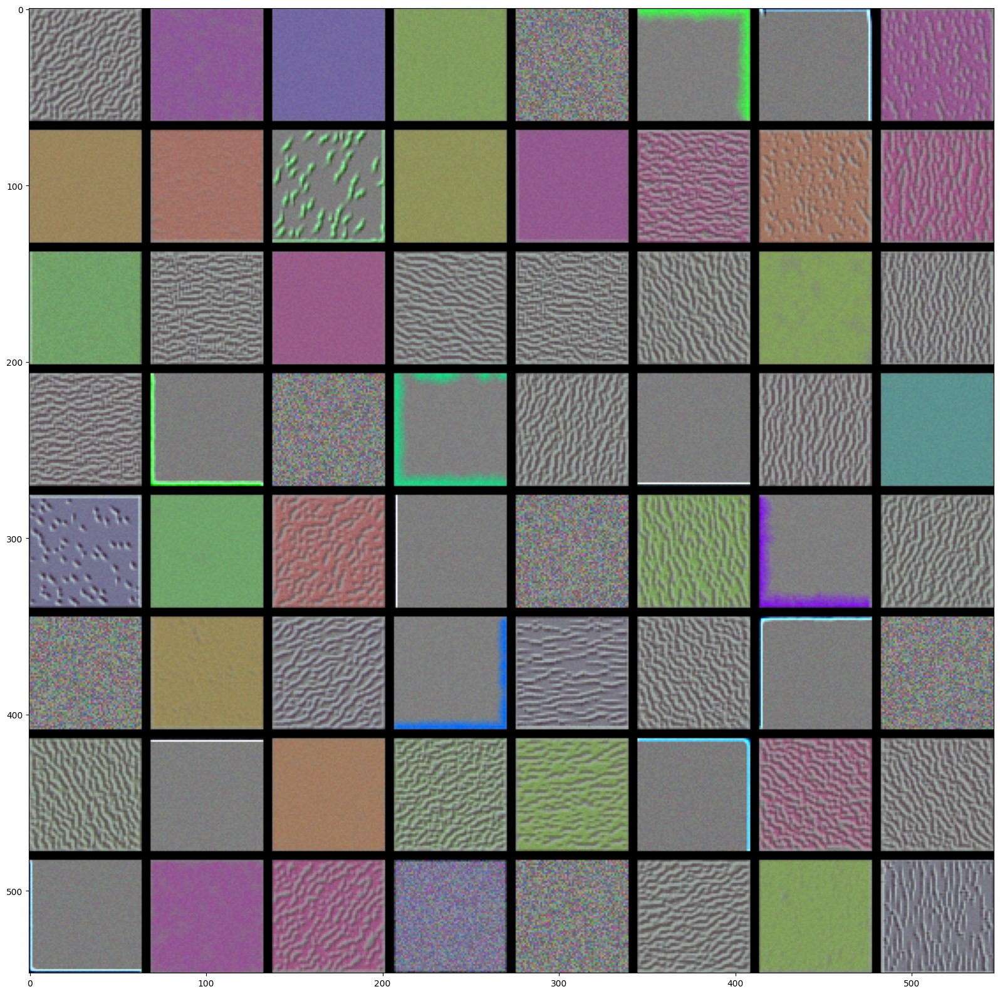

In [45]:
draw_layer_filters(layer_name_='block1_conv1', size_=64, margin_=5)

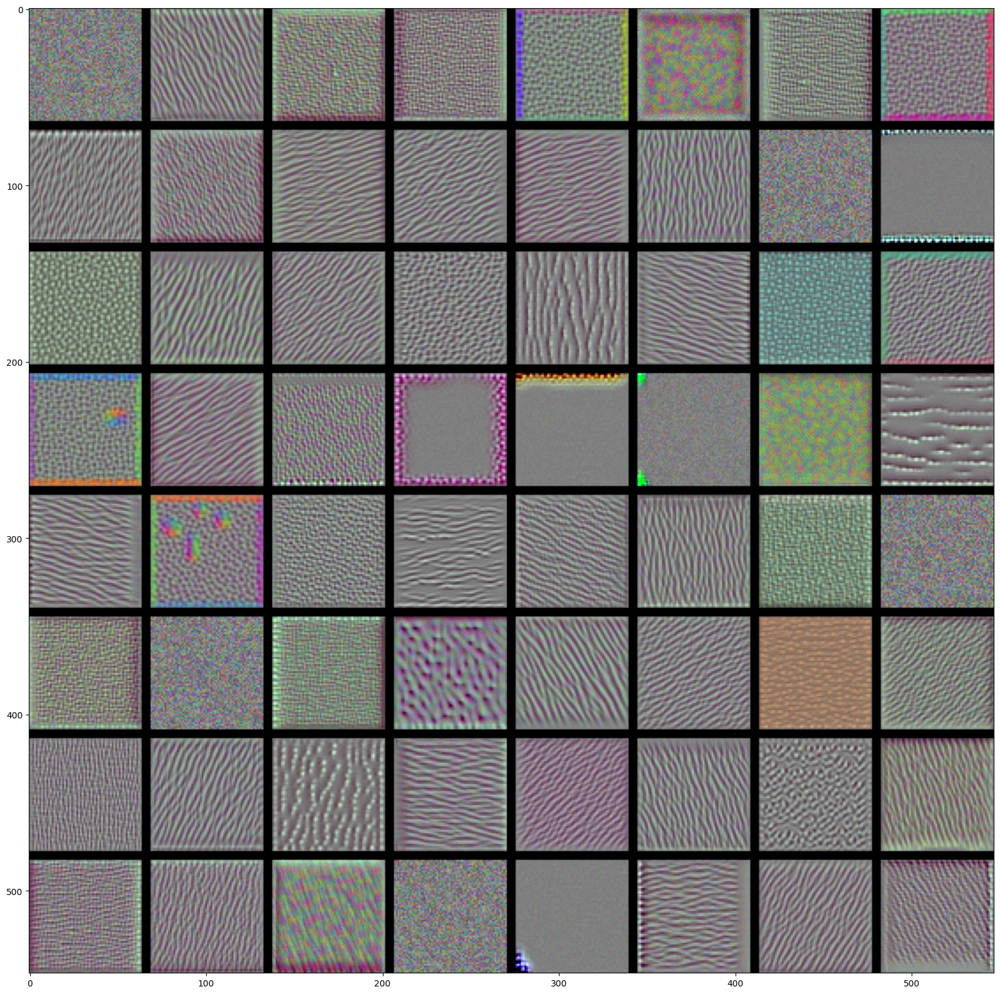

In [46]:
draw_layer_filters(layer_name_='block2_conv1', size_=64, margin_=5)

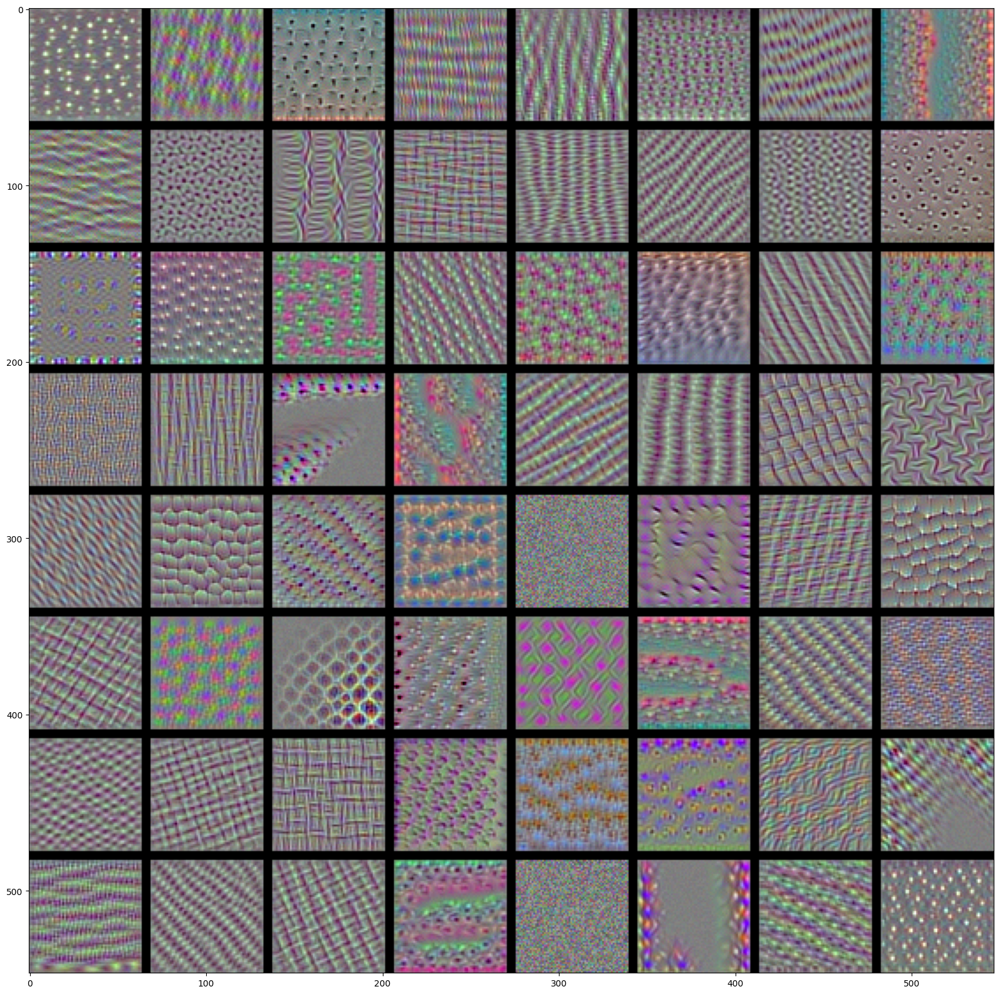

In [47]:
draw_layer_filters(layer_name_='block3_conv1', size_=64, margin_=5)

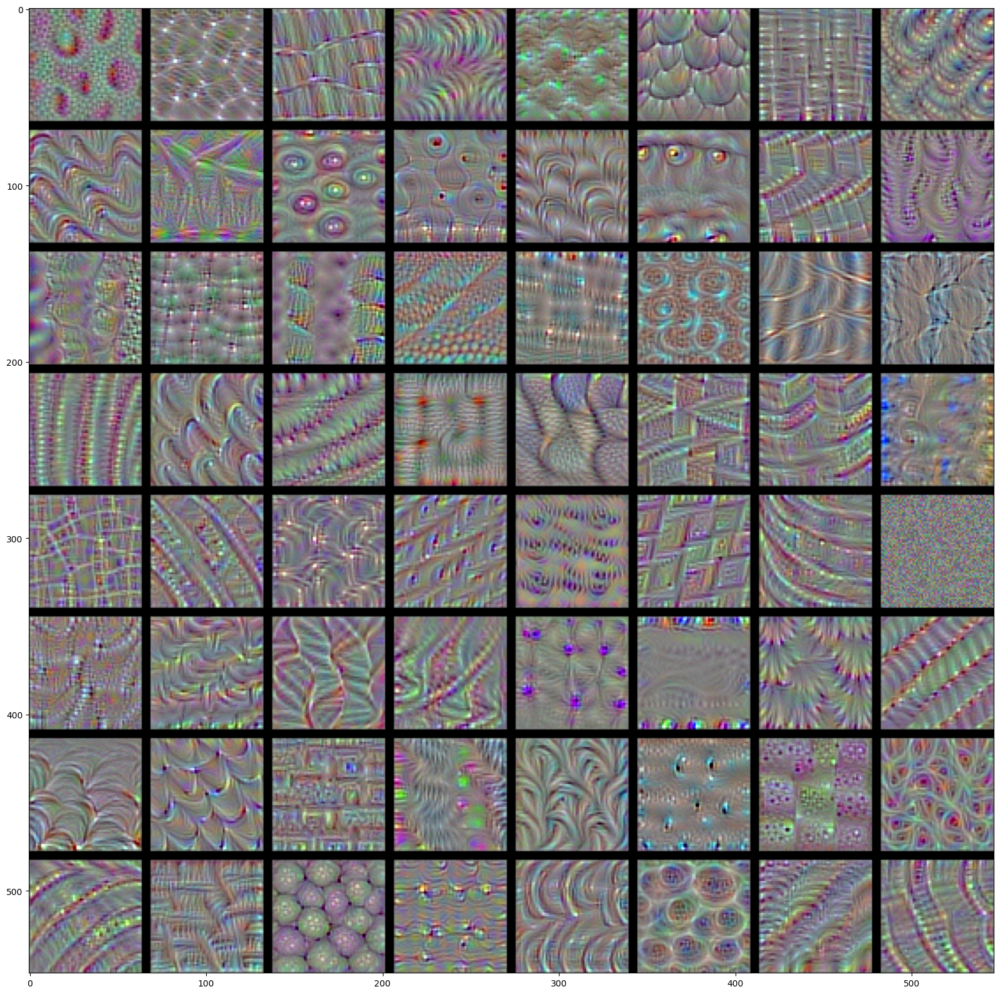

In [48]:
draw_layer_filters(layer_name_='block4_conv1', size_=64, margin_=5)

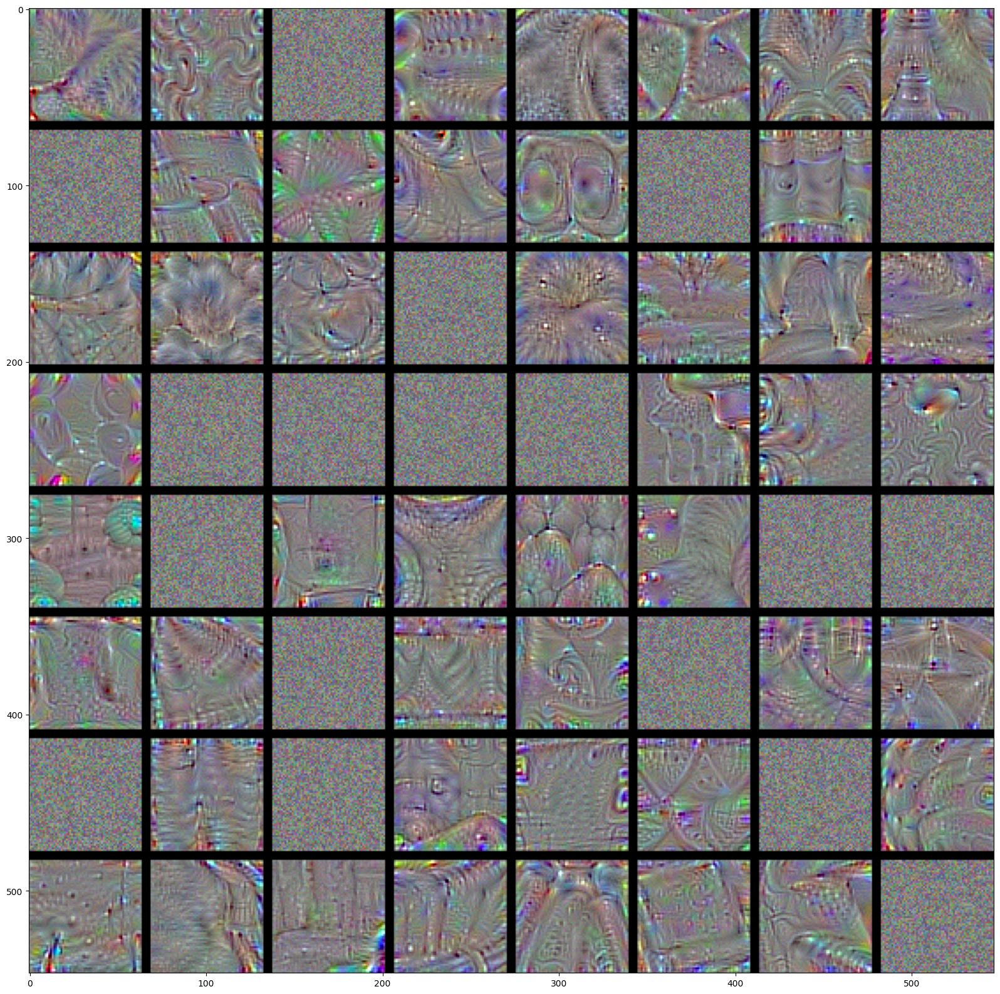

In [49]:
draw_layer_filters(layer_name_='block5_conv1', size_=64, margin_=5)